In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
import numpy as np
import scipy as sp
import pandas as pd
import theano as th
import theano.tensor as tt
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sb
import g3py as g3
import pymc3 as pm

#g3.style_seaborn()
#g3.style_normal()
g3.style_big()
#g3.style_big_seaborn()
g3.style_widget()

# Data

In [2]:
# Sunsets
x, y = g3.load_sunspots()
obs_j, x_obs, y_obs, test_j, x_test, y_test = g3.random_obs(x, y, 0.15)

::

    Number of Observations - 309 (Annual 1700 - 2008)
    Number of Variables - 1
    Variable name definitions::

        SUNACTIVITY - Number of sunspots for each year

    The data file contains a 'YEAR' variable that is not returned by load.

Total: 309 | Obs: 46 (14.88673139158576%)


# BoxCoxGP

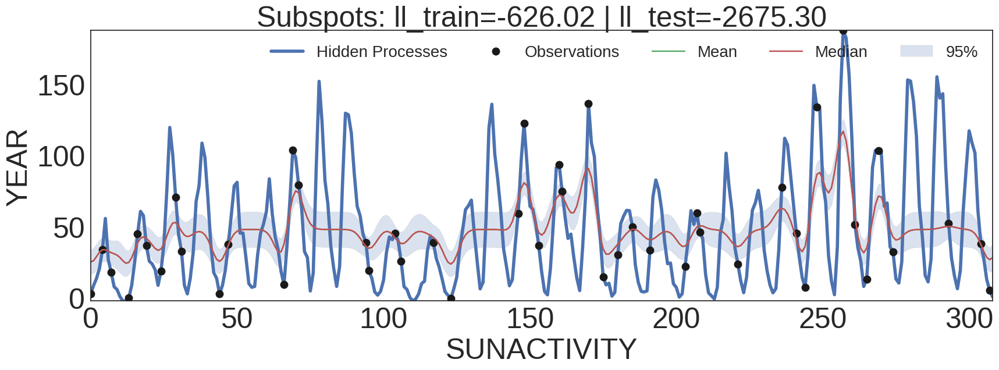

In [3]:
with g3.Model() as model:
    tgp = g3.TGP(x, g3.Bias(), g3.SE(x_obs), g3.BoxCoxShifted(y_obs), noise=True, hidden=y)
    tgp.describe('Subspots','SUNACTIVITY','YEAR')
    tgp.observed(x_obs,y_obs)
    tgp.testing(x_test,y_test)
    tgp.compile()
tgp.plot_tgp(tgp.find_default())

In [4]:
tgp.widget_params()

Widget Javascript not detected.  It may not be installed properly. Did you enable the widgetsnbextension? If not, then run "jupyter nbextension enable --py --sys-prefix widgetsnbextension"


         Current function value: 232.391922
         Iterations: 9
         Function evaluations: 47
         Gradient evaluations: 41
Optimization terminated successfully.
         Current function value: 222.615845
         Iterations: 8
         Function evaluations: 855
         Current function value: 232.255234
         Iterations: 3
         Function evaluations: 38
         Gradient evaluations: 32
Optimization terminated successfully.
         Current function value: 214.533585
         Iterations: 10
         Function evaluations: 1045
         Current function value: 222.615845
         Iterations: 0
         Function evaluations: 29
         Gradient evaluations: 17
Optimization terminated successfully.
         Current function value: 211.579208
         Iterations: 8
         Function evaluations: 907


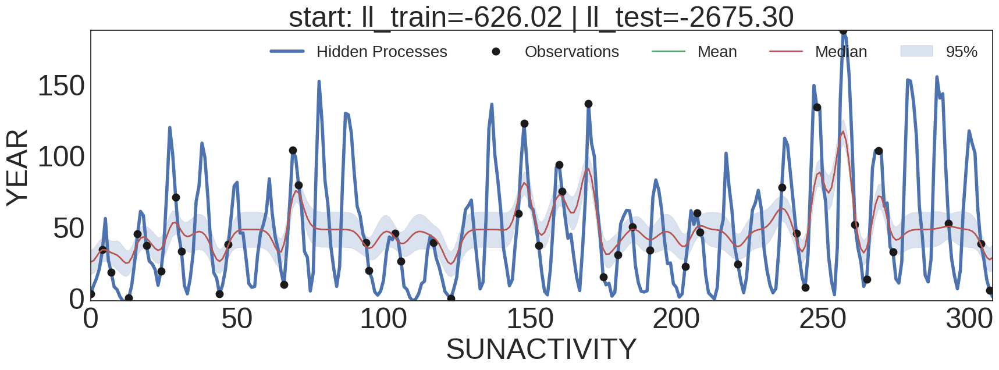

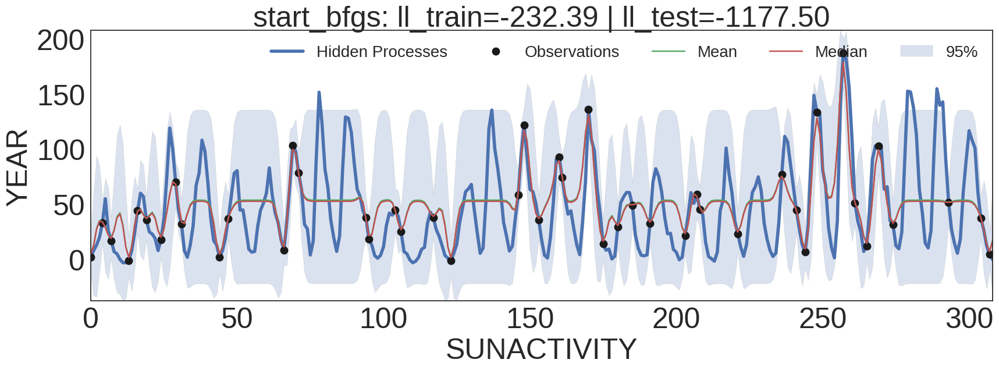

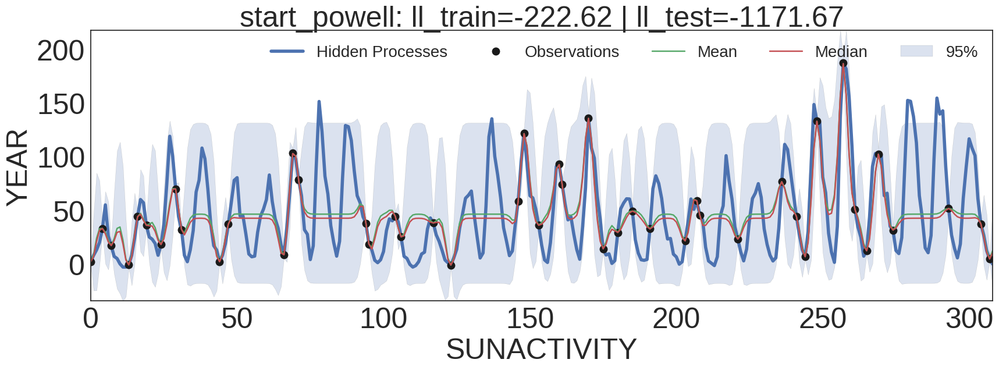

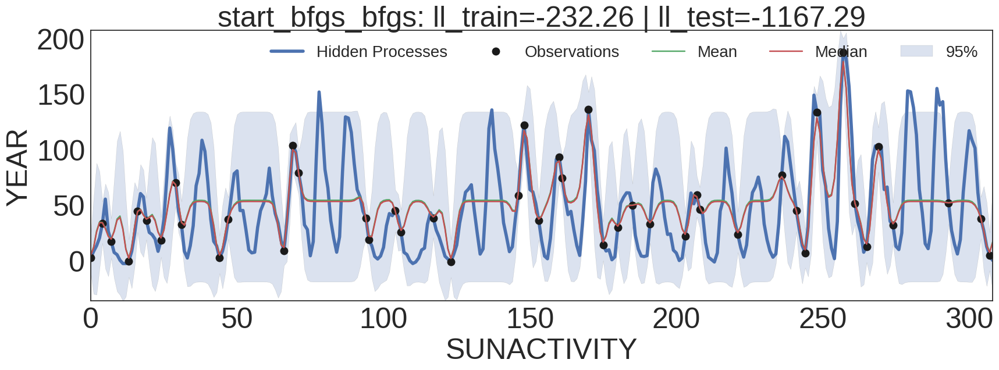

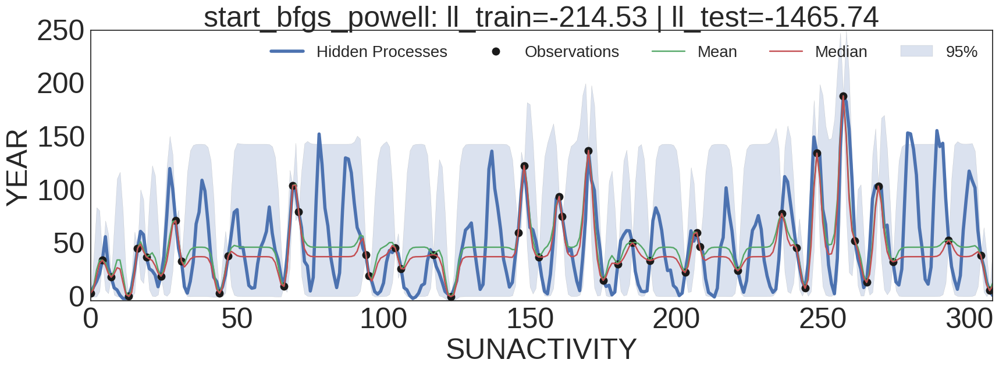

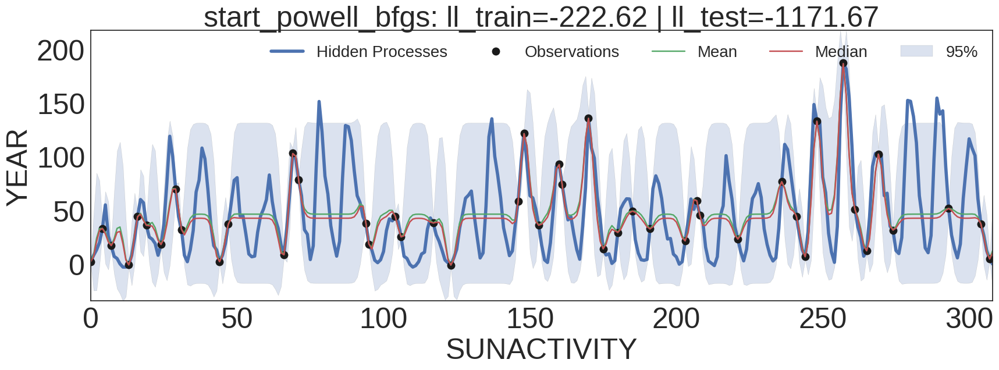

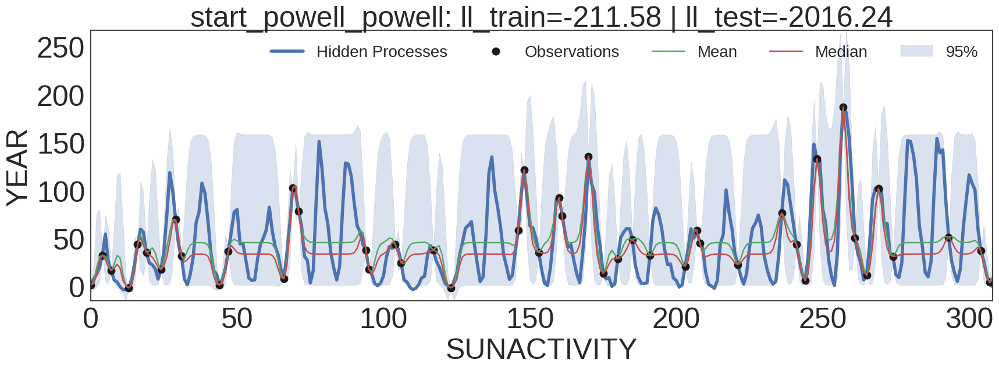

In [5]:
points = tgp.find_MAP(tgp.get_params(), 6, plot=True)

{'TGP_Bias_Constant': array(8.62967300415039, dtype=float32),
 'TGP_BoxCoxShifted_power_log_': array(-0.7670242190361023, dtype=float32),
 'TGP_BoxCoxShifted_shift': array(-4.999999523162842, dtype=float32),
 'TGP_Noise_Var_log_': array(-148.17742919921875, dtype=float32),
 'TGP_SE_ARD_L2_Scales_log_': array(0.841962993144989, dtype=float32),
 'TGP_SE_Var_log_': array(3.5781729221343994, dtype=float32)}

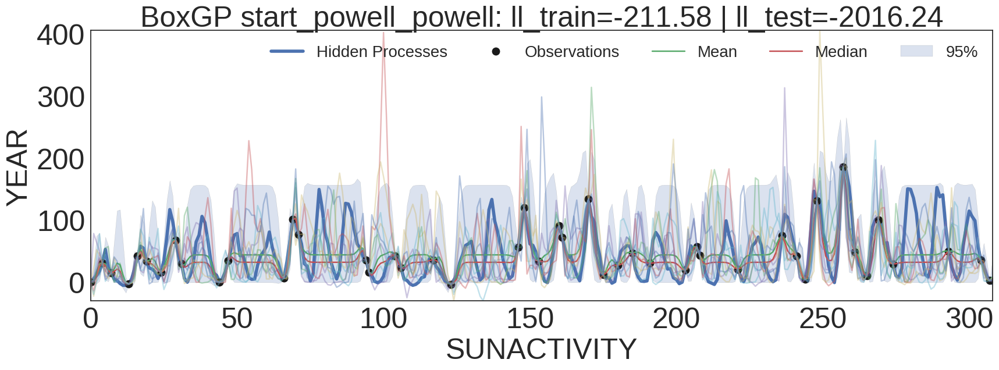

In [6]:
optimal = points[0]
for test in points:
    if test[1] > optimal[1]:
        optimal = test
name, logp, params = optimal

tgp.plot_tgp(params,'BoxGP '+name, samples=10)
g3.save_plot('bcgp_optimal.pdf')

params

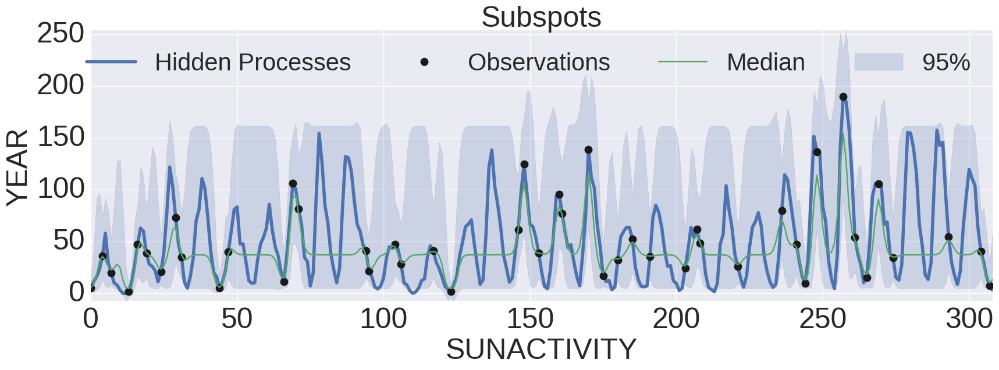

In [33]:
tgp.widget_params()

In [34]:
tgp.get_params()

{'TGP_Bias_Constant': array(8.62967300415039),
 'TGP_BoxCoxShifted_power_log_': array(-0.7670242190361023),
 'TGP_BoxCoxShifted_shift': array(-4.999999523162842),
 'TGP_Noise_Var_log_': array(2.0),
 'TGP_SE_ARD_L2_Scales_log_': array(0.841962993144989),
 'TGP_SE_Var_log_': array(3.5781729221343994)}

In [55]:
th.config.exception_verbosity = 'high'

In [ ]:
traces = tgp.sample_hypers(start=tgp.get_params(), samples=5000)

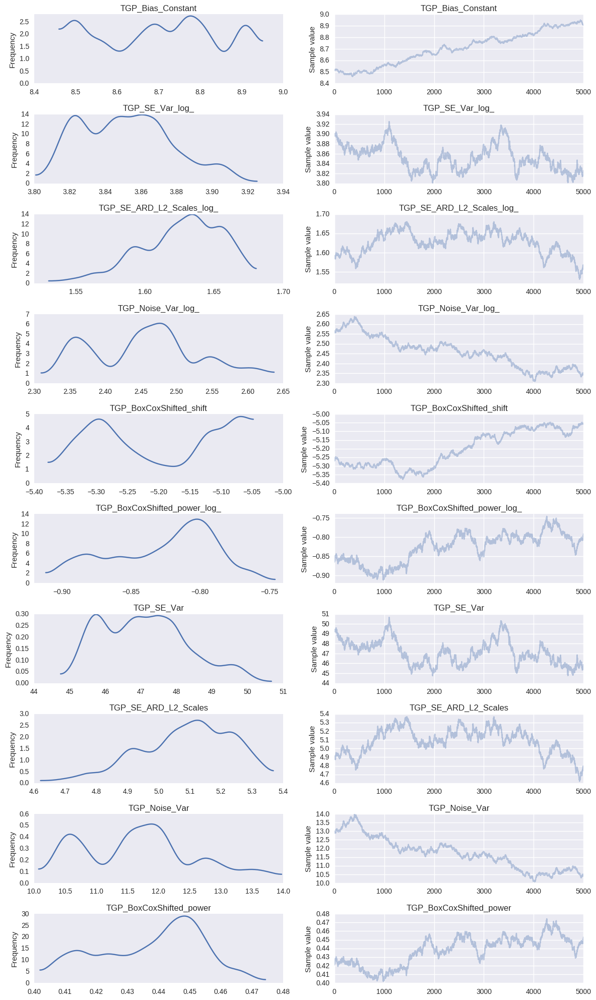

In [57]:
g3.style_seaborn()
g3.traceplot(traces)

In [58]:
datatraces = g3.datatrace(model, traces)
datatraces.describe().T

,count,mean,std,min,25%,50%,75%,max
TGP_BoxCoxShifted_shift,5000.0,-5.203122,0.101792,-5.377591,-5.296489,-5.221498,-5.107175,-5.047973
TGP_BoxCoxShifted_power,5000.0,0.437536,0.016602,0.401884,0.423805,0.441478,0.450213,0.474324
TGP_SE_ARD_L2_Scales,5000.0,5.084969,0.149910,4.620681,4.984325,5.101723,5.204747,5.368328
TGP_SE_Var,5000.0,47.110081,1.229299,44.743011,46.031610,47.034559,47.911507,50.669224
TGP_Bias_Constant,5000.0,8.704442,0.140778,8.459850,8.571261,8.704398,8.810138,8.950415
TGP_Noise_Var,5000.0,11.722439,0.926295,10.072741,10.850464,11.719577,12.208929,13.974476
niter,5000.0,2499.500000,1443.520003,0.000000,1249.750000,2499.500000,3749.250000,4999.000000
ll,5000.0,-231.278098,2.352669,-235.887131,-233.557491,-230.717262,-229.364510,-226.848145
adll,5000.0,59.277032,4.503843,47.684452,56.324414,59.821054,62.480118,72.313210


/home/grios/anaconda3/lib/python3.5/site-packages/statsmodels/nonparametric/kdetools.py:20: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  y = X[:m/2+1] + np.r_[0,X[m/2+1:],0]*1j


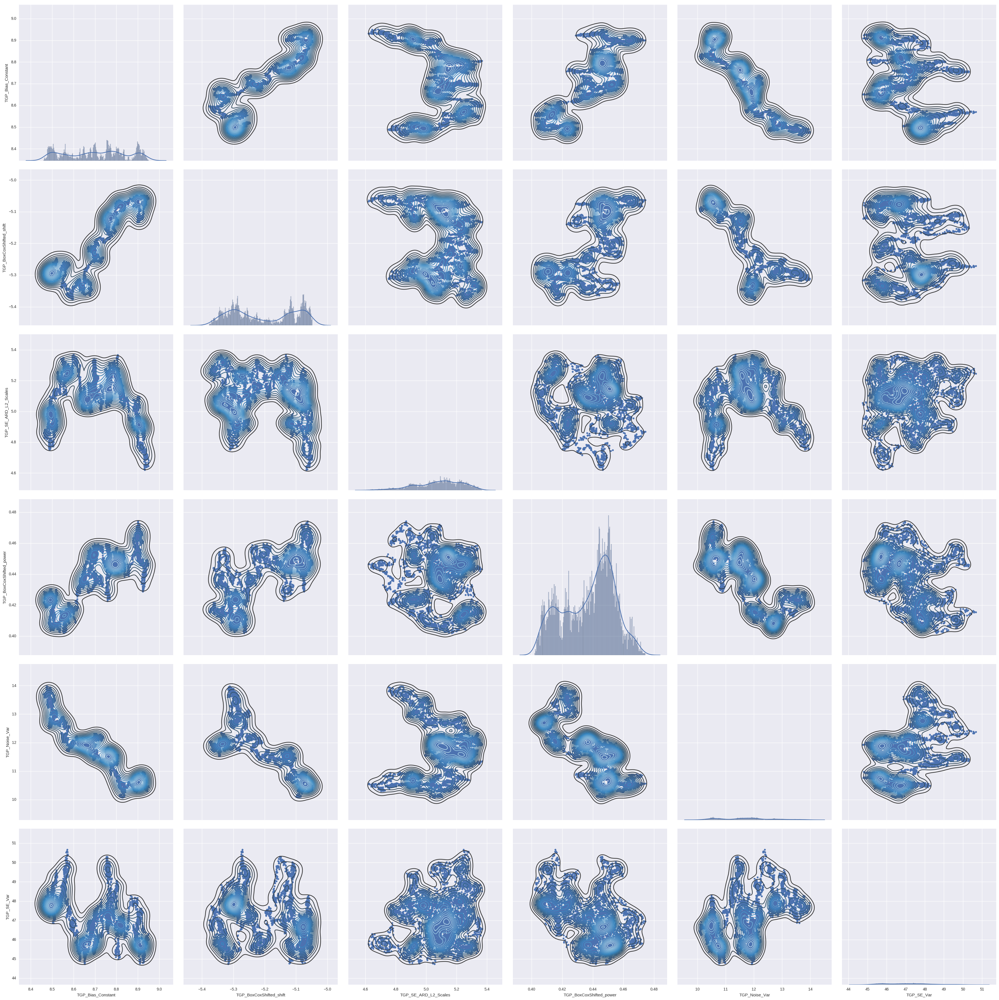

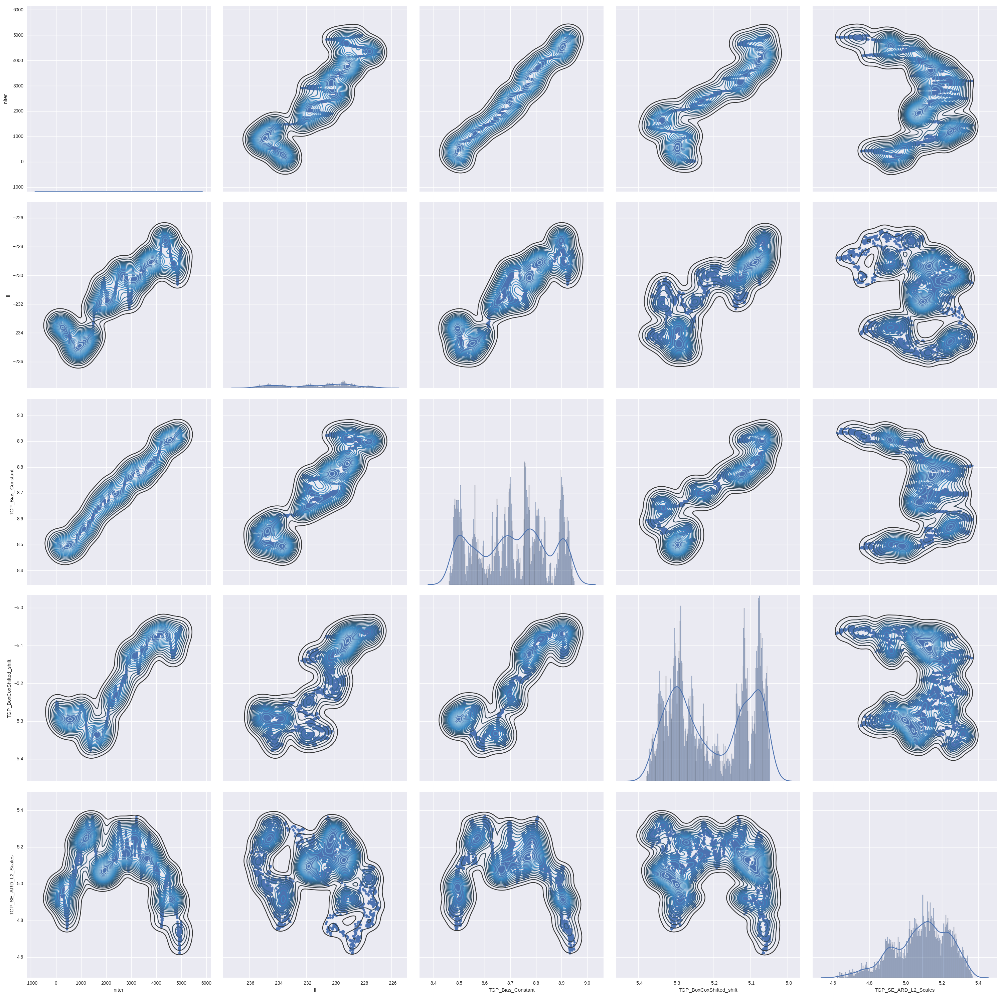

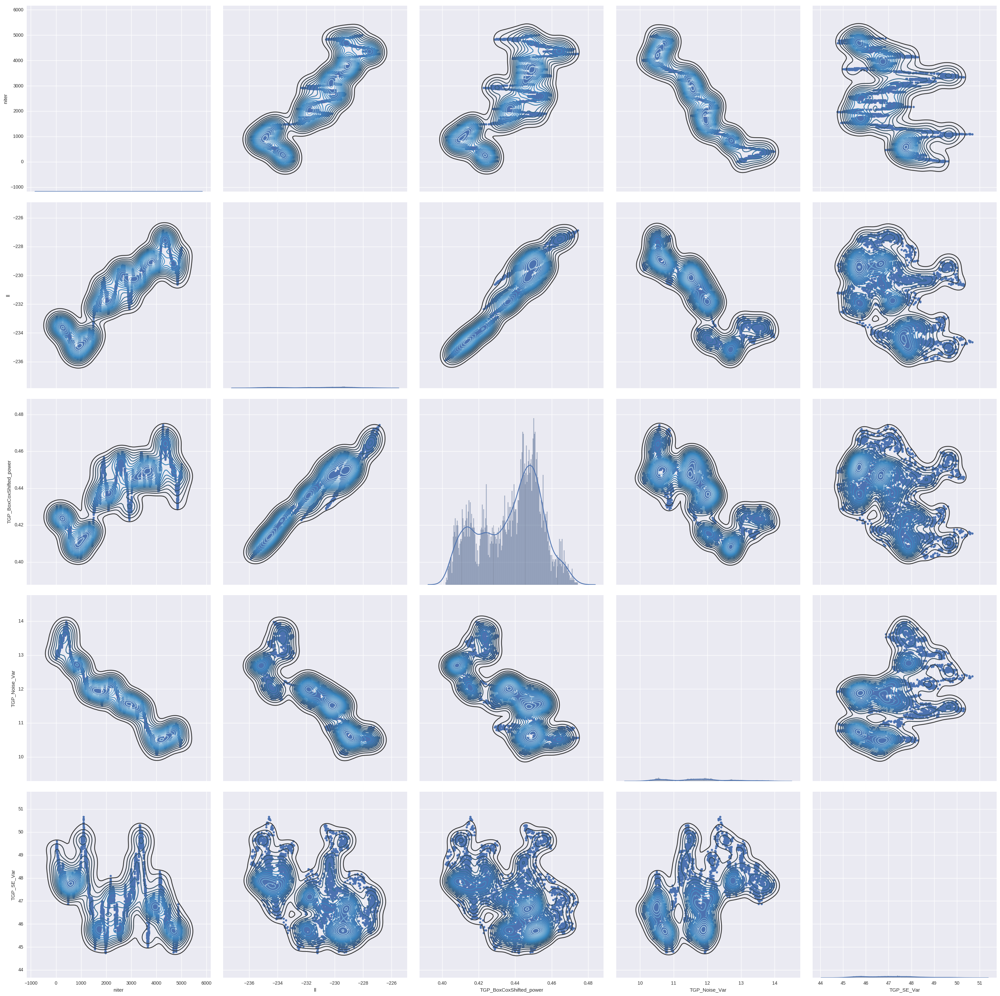

In [59]:
items_ll = ['niter','ll']
items_mt = ['TGP_Bias_Constant','TGP_BoxCoxShifted_shift','TGP_SE_ARD_L2_Scales']
items_k = ['TGP_BoxCoxShifted_power', 'TGP_Noise_Var','TGP_SE_Var']

g3.plot_datatrace(datatraces,items_mt+items_k)
g3.plot_datatrace(datatraces,items_ll+items_mt)
g3.plot_datatrace(datatraces,items_ll+items_k)

In [73]:
g3.style_seaborn()

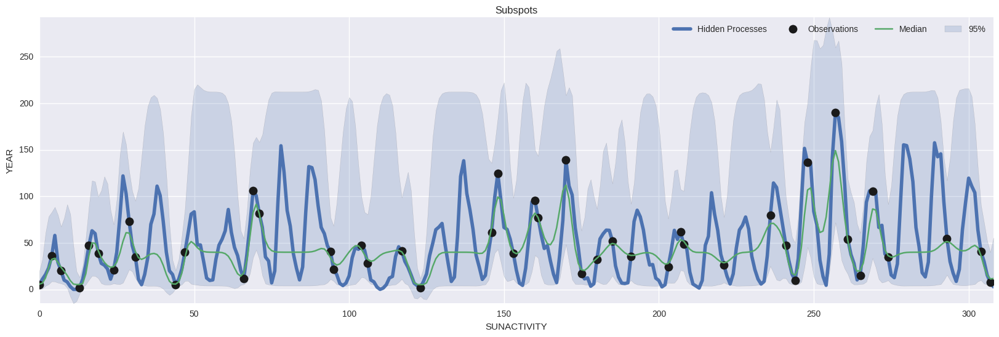

In [75]:
tgp.widget_trace(traces)

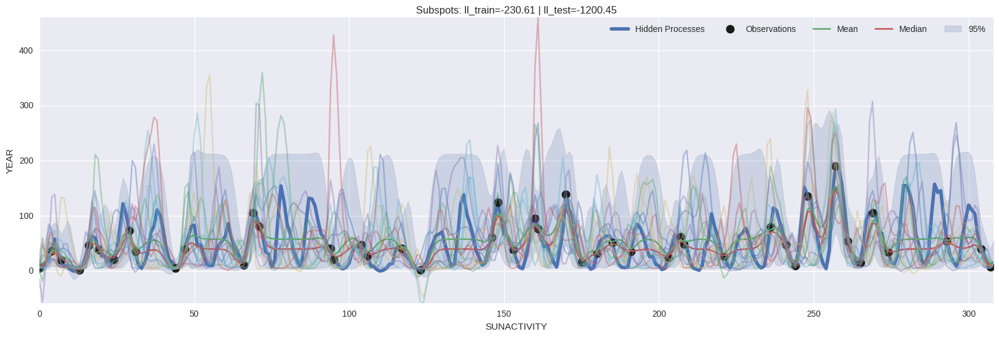

In [80]:
tgp.plot_tgp(tgp.get_params(), samples=15)